In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
! unzip '/content/drive/MyDrive/real-vs-fake.zip'

Streaming output truncated to the last 5000 lines.
  inflating: real-vs-fake/valid/fake/00JMWC4S8R.jpg  
  inflating: real-vs-fake/valid/fake/00V8VPXL3V.jpg  
  inflating: real-vs-fake/valid/fake/00W5NPIX4S.jpg  
  inflating: real-vs-fake/valid/fake/012N2T4FKG.jpg  
  inflating: real-vs-fake/valid/fake/013O4R3GO3.jpg  
  inflating: real-vs-fake/valid/fake/016SOBIEG7.jpg  
  inflating: real-vs-fake/valid/fake/01BEBDIRC8.jpg  
  inflating: real-vs-fake/valid/fake/01NH00JKMJ.jpg  
  inflating: real-vs-fake/valid/fake/01OQZLB87L.jpg  
  inflating: real-vs-fake/valid/fake/023TT8SISF.jpg  
  inflating: real-vs-fake/valid/fake/02ALRVUDUP.jpg  
  inflating: real-vs-fake/valid/fake/02BUIANKWL.jpg  
  inflating: real-vs-fake/valid/fake/02UDY3RXJ0.jpg  
  inflating: real-vs-fake/valid/fake/02WNXR4DIV.jpg  
  inflating: real-vs-fake/valid/fake/02XZQCN0ND.jpg  
  inflating: real-vs-fake/valid/fake/02YW5GZPFO.jpg  
  inflating: real-vs-fake/valid/fake/036PU7OT48.jpg  
  inflating: real-vs-fake/valid

In [ ]:
!pip3 install catboost

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 76.6 MB 166 kB/s 


In [ ]:
import os
import random
import warnings

import cv2
import gdown
from functools import partial

warnings.simplefilter(action="ignore")
os.environ["TF_CPP_MIN_LOG_LEVEL"] = "3"
os.environ["XLA_PYTHON_CLIENT_PREALLOCATE"] = "false"

import numpy as np
import pandas as pd
from matplotlib import cm
from numpy.random import rand
import matplotlib.pyplot as plt

In [ ]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import backend
from tensorflow.keras import layers

physical_devices = tf.config.list_physical_devices("GPU")
try:
    tf.config.experimental.set_memory_growth(physical_devices[0], True)
    tf.config.optimizer.set_jit(True)
    keras.mixed_precision.set_global_policy("mixed_float16")
except:
    pass

seed = 1337
tf.random.set_seed(seed)

Your GPU may run slowly with dtype policy mixed_float16 because it does not have compute capability of at least 7.0. Your GPU:
  Tesla P100-PCIE-16GB, compute capability 6.0
See https://developer.nvidia.com/cuda-gpus for a list of GPUs and their compute capabilities.
If you will use compatible GPU(s) not attached to this host, e.g. by running a multi-worker model, you can ignore this warning. This message will only be logged once


In [ ]:
def get_model_weight(model_id):
    """Get the trained weights."""
    if not os.path.exists("/content/model/model.tf"):
        model_weight = gdown.download(id=model_id, quiet=False)
    else:
        model_weight = "/content/model/model.tf"
    return model_weight


def get_model_history(history_id):
    """Get the history / log file."""
    if not os.path.exists("/content/model/history.csv"):
        history_file = gdown.download(id=history_id, quiet=False)
    else:
        history_file = "/content/model/history.csv"
    return history_file


def make_plot(tfdata, take_batch=1, title=True, figsize=(20, 20)):
    """ref: https://bit.ly/3QmYy9p"""

    font = {
        "family": "serif",
        "color": "darkred",
        "weight": "normal",
        "size": 15,
    }

    for images, labels in tfdata.take(take_batch):
        plt.figure(figsize=figsize)
        xy = int(np.ceil(images.shape[0] * 0.5))

        for i in range(images.shape[0]):
            plt.subplot(xy, xy, i + 1)
            plt.imshow(tf.cast(images[i], dtype=tf.uint8))
            if title:
                plt.title(tcls_names[tf.argmax(labels[i], axis=-1)], fontdict=font)
            plt.axis("off")

    plt.tight_layout()
    plt.show()

In [ ]:
class Parameters:
    # data level
    image_size = 384
    batch_size = 8
    num_grad_accumulation = 8
    label_smooth=0.05
    class_number = 2
    val_split = 0.2 
    verbosity = 2
    autotune = tf.data.AUTOTUNE
    
    # hparams
    epochs = 20
    lr_sched = 'cosine_restart' # [or, exponential, cosine, linear, constant]
    lr_base  = 0.016
    lr_min   = 0
    lr_decay_epoch  = 2.4
    lr_warmup_epoch = 5
    lr_decay_factor = 0.97
    scaled_lr = lr_base * (batch_size / 256.0)
    scaled_lr_min = lr_min * (batch_size / 256.0)
    num_validation_sample = 5000
    num_training_sample = 25000
    train_step = int(np.ceil(num_training_sample / float(batch_size)))
    total_steps = train_step * epochs
   


params = Parameters()

In [ ]:
base_dir = "/content/real-vs-fake/"
train_dir = os.path.join(base_dir, 'train')
test_dir = os.path.join(base_dir, 'test')
valid_dir = os.path.join(base_dir, 'valid')

In [ ]:
seed = 43
def get_image_data(data_path, image_size, seed = None, subset = None, validation_split = None):
    if subset:
        validation_split = 0.2
    raw_data_set = \
    tf.keras.preprocessing.image_dataset_from_directory(
        data_path,
        image_size=image_size,
        seed=seed,
        validation_split=validation_split, 
        subset=subset
    )
    
    raw_data_set.class_names.sort()
    
    return {
        "data": raw_data_set.cache().prefetch(
        buffer_size = tf.data.experimental.AUTOTUNE
        ),
        "classNames": raw_data_set.class_names
    }

In [ ]:
test_ds = get_image_data(
    test_dir,
    image_size = (params.image_size, params.image_size),
)

Found 5000 files belonging to 2 classes.


In [ ]:
train_set = keras.utils.image_dataset_from_directory(
    train_dir,
    validation_split=params.val_split,
    subset="training",
    label_mode='categorical',
    seed=params.image_size,
    image_size=(params.image_size, params.image_size),
    batch_size=params.batch_size,
)

val_set = keras.utils.  (
    valid_dir,
    validation_split=params.val_split,
    subset="validation",
    label_mode='categorical',
    seed=params.image_size,
    image_size=(params.image_size, params.image_size),
    batch_size=params.batch_size,
)

tcls_names, vcls_names = train_set.class_names , val_set.class_names
tcls_names, vcls_names 

Found 25000 files belonging to 2 classes.
Using 20000 files for training.
Found 5000 files belonging to 2 classes.
Using 1000 files for validation.


(['fake', 'real'], ['fake', 'real'])

In [ ]:
test_ds = tf.keras.utils.image_dataset_from_directory(
    test_dir,
    seed=1337,
    image_size=(params.image_size, params.image_size),
    batch_size=params.batch_size,
)

Found 5000 files belonging to 2 classes.


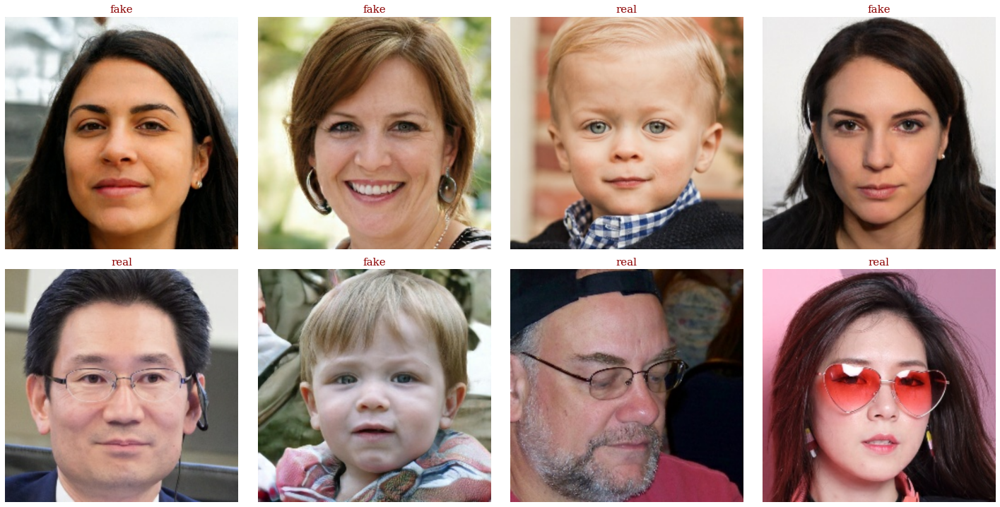

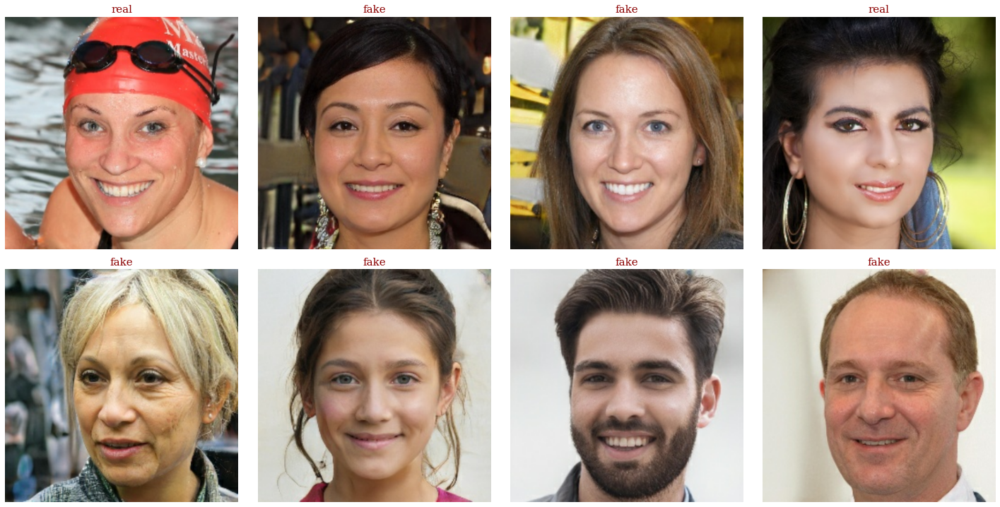

In [ ]:
make_plot(train_set, title=True) 
make_plot(val_set,  title=True) 

In [ ]:
class RandomApply(layers.Layer):
    """RandomApply will randomly apply the transformation layer
    based on the given probability.
    
    Ref. https://stackoverflow.com/a/72558994/9215780
    """

    def __init__(self, layer, probability, **kwargs):
        super().__init__(**kwargs)
        self.layer = layer
        self.probability = probability

    def call(self, inputs, training=True):
        apply_layer = tf.random.uniform([]) < self.probability
        outputs = tf.cond(
            pred=tf.logical_and(apply_layer, training),
            true_fn=lambda: self.layer(inputs),
            false_fn=lambda: inputs,
        )
        return outputs

    def get_config(self):
        config = super().get_config()
        config.update(
            {
                "layer": layers.serialize(self.layer),
                "probability": self.probability,
            }
        )
        return config

JAX

In [ ]:
import jax
from jax import jit
from jax import random
from jax import numpy as jnp
from jax.experimental import jax2tf

In [ ]:
class RandomChannelShuffle(layers.Layer):
    """Shuffle channels of an input image.

    Ref. https://gist.github.com/innat/35ab35329e2ca890a17556384056334b
    """
    def __init__(self, groups=3, **kwargs):
        super().__init__(**kwargs)
        self.groups = groups

    @partial(jit, static_argnums=0)
    def _jax_channel_shuffling(self, images):
        batch_size, height, width, num_channels = images.shape

        if not num_channels % self.groups == 0:
            raise ValueError(
                "The number of input channels should be "
                "divisible by the number of groups."
                f"Received: channels={num_channels}, groups={self.groups}"
            )

        channels_per_group = num_channels // self.groups

        images = images.reshape(-1, height, width, self.groups, channels_per_group)
        images = images.transpose([3, 1, 2, 4, 0])
        key = random.PRNGKey(np.random.randint(50))
        images = random.permutation(key=key, x=images, axis=0)
        images = images.transpose([4, 1, 2, 3, 0])
        images = images.reshape(-1, height, width, num_channels)
        return images

    def call(self, images, training=True):
        if training:
            return jax2tf.convert(
                self._jax_channel_shuffling, polymorphic_shapes=("batch, ...")
            )(images)
        else:
            return images
    
    def get_config(self):
        config = {
            "groups": self.groups,
        }
        base_config = super().get_config()
        return dict(list(base_config.items()) + list(config.items()))

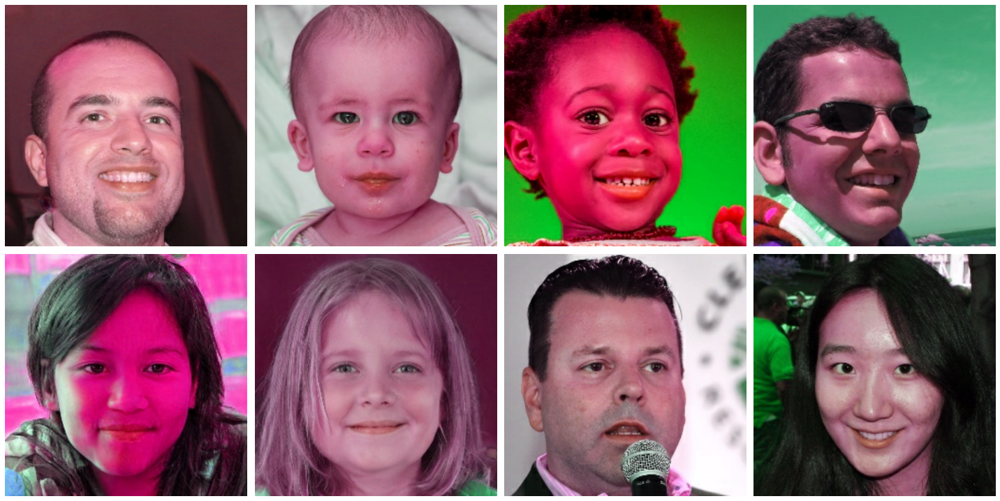

In [ ]:
temp_ds = train_set.map(
    lambda x, y: (RandomChannelShuffle()(x), y), num_parallel_calls=params.autotune
)
make_plot(temp_ds, take_batch=1, title=False) 

GrayScaling (jax2tf)

In [ ]:
class RandomGrayscale(layers.Layer):
    """Grayscale is a preprocessing layer that transforms
    RGB images to Grayscale images.

    Ref. https://gist.github.com/innat/4e89725ccdcd763e0a6ba19216fd60bf
    """

    def __init__(self, output_channel=1, prob=1, **kwargs):
        super().__init__(**kwargs)
        self.output_channel = self._check_input_params(output_channel)

    def _check_input_params(self, output_channels):
        if output_channels not in [1, 3]:
            raise ValueError(
                "Received invalid argument output_channels. "
                f"output_channels must be in 1 or 3. Got {output_channels}"
            )
        return output_channels

    @partial(jit, static_argnums=0)
    def _jax_gray_scale(self, images):
        rgb_weights = jnp.array([0.2989, 0.5870, 0.1140], dtype=images.dtype)
        grayscale = (rgb_weights * images).sum(axis=-1)

        if self.output_channel == 1:
            grayscale = jnp.expand_dims(grayscale, axis=-1)
            return grayscale
        elif self.output_channel == 3:
            return jnp.stack([grayscale] * 3, axis=-1)
        else:
            raise ValueError("Unsupported value for `output_channels`.")

    def call(self, images, training=True):
        if training:
            return jax2tf.convert(
                self._jax_gray_scale, polymorphic_shapes=("batch, ...")
            )(images)
        else:
            return images

    def get_config(self):
        config = {
            "output_channel": self.output_channel,
        }
        base_config = super().get_config()
        return dict(list(base_config.items()) + list(config.items()))

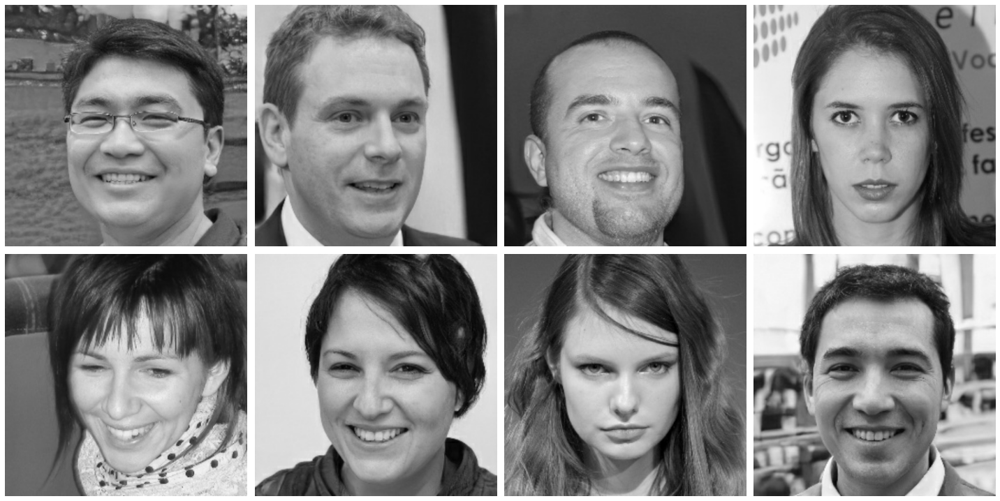

In [ ]:
temp_ds = train_set.map(
    lambda x, y: (RandomGrayscale(output_channel=3)(x), y), num_parallel_calls=params.autotune
)
make_plot(temp_ds, take_batch=1, title=False) 

In [ ]:
jax_to_keras_augment = keras.Sequential(
    [
        RandomApply(RandomGrayscale(output_channel=3), probability=0.2),
        RandomApply(RandomChannelShuffle(), probability=0.5),
    ],
    name="jax2keras_augment",
)


tf_to_keras_augment = keras.Sequential(
    [
        RandomApply(layers.RandomFlip("horizontal"), probability=0.5),
        RandomApply(layers.RandomZoom(0.2, 0.3), probability=0.2),
        RandomApply(
            layers.RandomRotation((0.2, 0.3), fill_mode="reflect"), probability=0.8
        ),
    ],
    name="tf2keras_augment",
)

In [ ]:
# for train set : augmentation
keras_aug = keras.Sequential(
    [
        layers.Resizing(height=params.image_size, width=params.image_size),
        jax_to_keras_augment,
        tf_to_keras_augment,
    ],
    name="keras_augment",
)

train_ds = train_set.shuffle(10 * params.batch_size)
train_ds = train_ds.map(
    lambda x, y: (keras_aug(x), y), num_parallel_calls=params.autotune
)



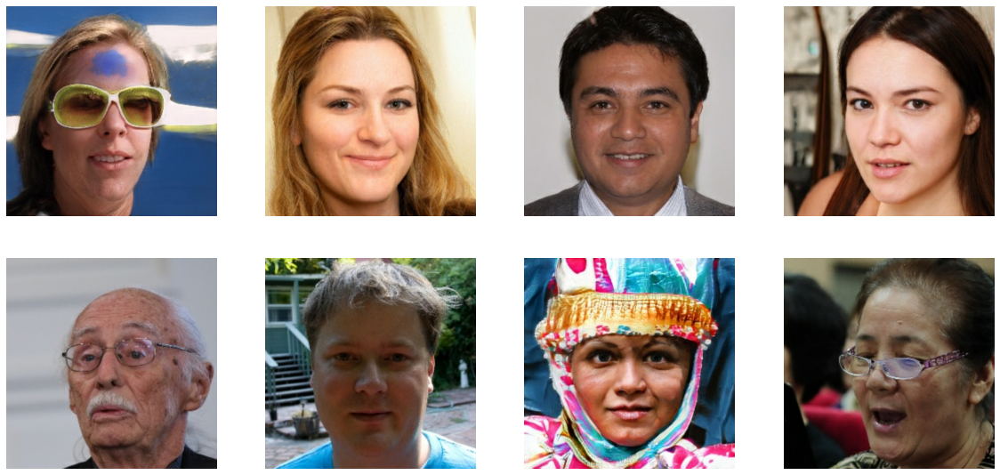

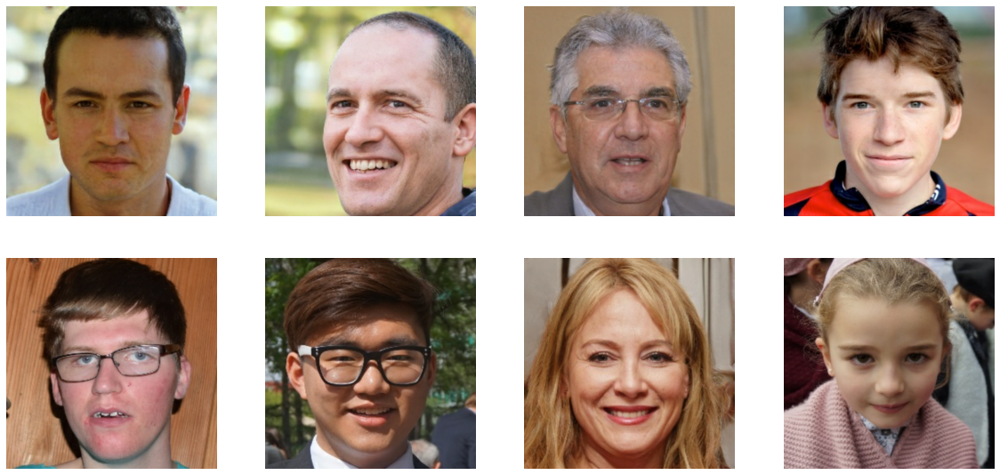

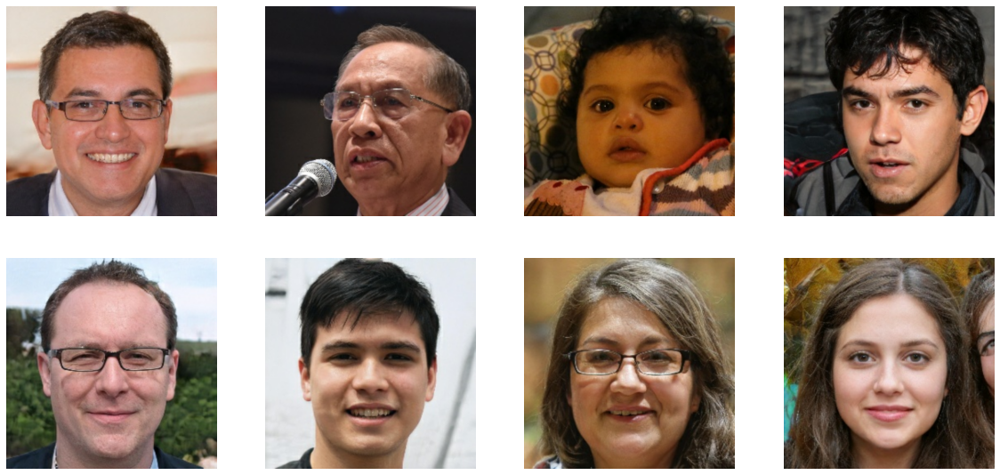

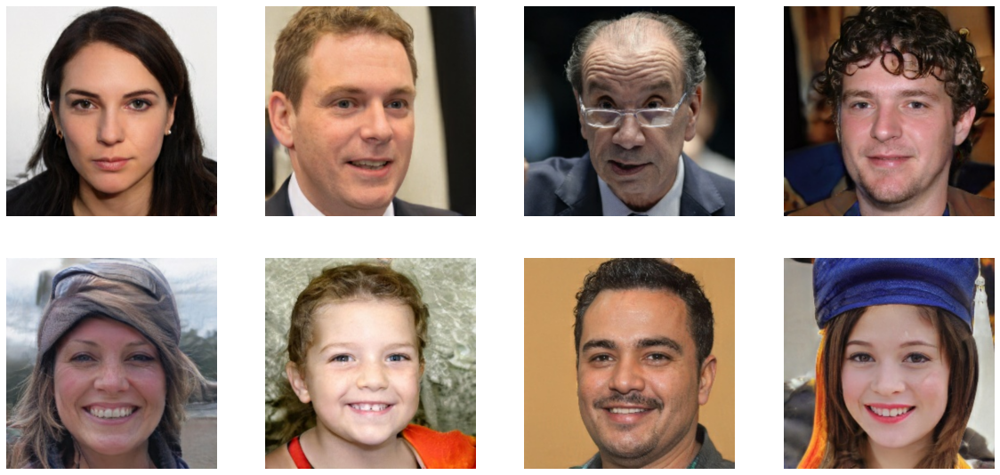

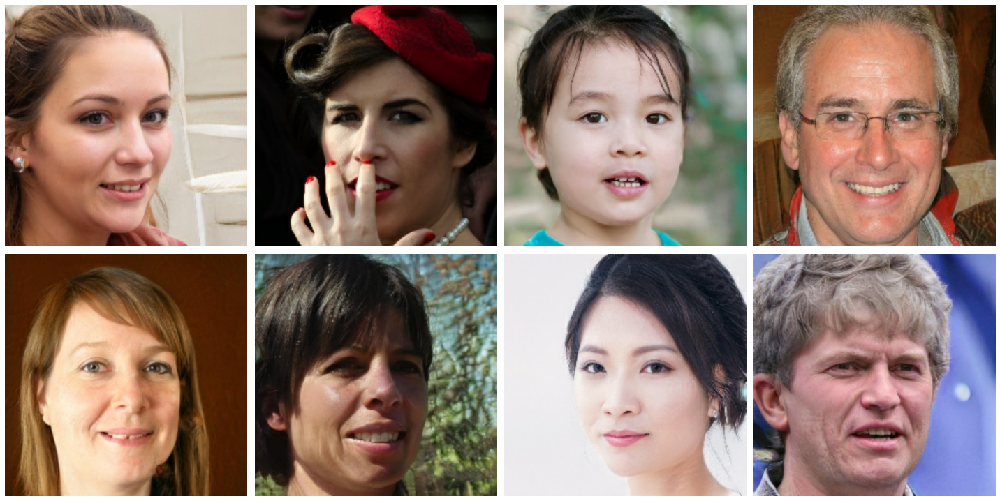

In [ ]:
make_plot(train_ds, take_batch=5, title=False) 

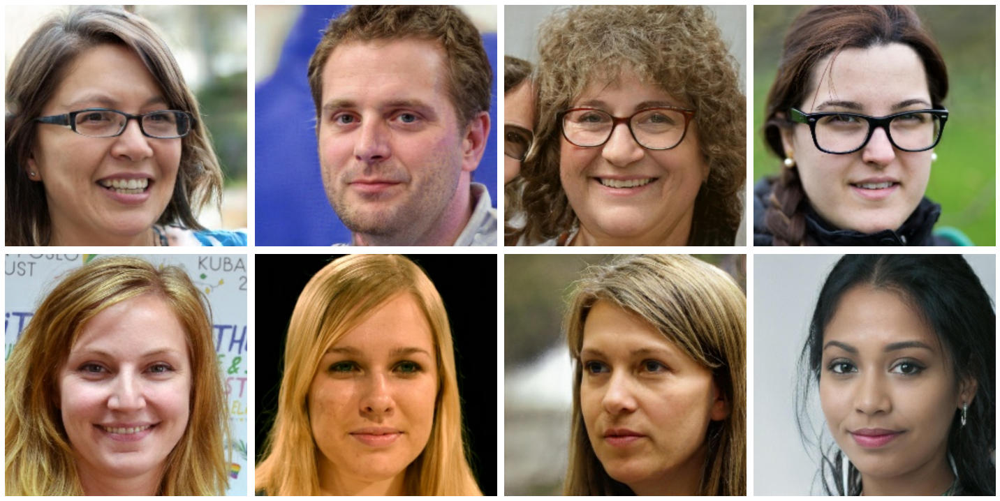

In [ ]:
make_plot(val_set, take_batch=1, title=False) 

In [ ]:
train_ds = train_ds.prefetch(buffer_size=params.autotune)
val_ds = val_set.prefetch(buffer_size=params.autotune)

Modelling

In [ ]:
patch_size      = (2,2)   # 2-by-2 sized patches
dropout_rate    = 0.5     # Dropout rate
num_heads       = 8       # Attention heads
embed_dim       = 64      # Embedding dimension
num_mlp         = 128     # MLP layer size
qkv_bias        = True    # Convert embedded patches to query, key, and values
window_size     = 2       # Size of attention window
shift_size      = 1       # Size of shifting window
image_dimension = 24      # Initial image size / Input size of the transformer model 

num_patch_x = image_dimension // patch_size[0]
num_patch_y = image_dimension // patch_size[1]

In [ ]:
def window_partition(x, window_size):
    _, height, width, channels = x.shape
    patch_num_y = height // window_size
    patch_num_x = width // window_size
    x = tf.reshape(
        x, shape=(-1, patch_num_y, window_size, patch_num_x, window_size, channels)
    )
    x = tf.transpose(x, (0, 1, 3, 2, 4, 5))
    windows = tf.reshape(x, shape=(-1, window_size, window_size, channels))
    return windows


def window_reverse(windows, window_size, height, width, channels):
    patch_num_y = height // window_size
    patch_num_x = width // window_size
    x = tf.reshape(
        windows,
        shape=(-1, patch_num_y, patch_num_x, window_size, window_size, channels),
    )
    x = tf.transpose(x, perm=(0, 1, 3, 2, 4, 5))
    x = tf.reshape(x, shape=(-1, height, width, channels))
    return x


class DropPath(layers.Layer):
    def __init__(self, drop_prob=None, **kwargs):
        super(DropPath, self).__init__(**kwargs)
        self.drop_prob = drop_prob

    def call(self, inputs, training=None):
        if self.drop_prob == 0.0 or not training:
            return inputs
        else:
            batch_size = tf.shape(inputs)[0]
            keep_prob = 1 - self.drop_prob
            path_mask_shape = (batch_size,) + (1,) * (len(tf.shape(inputs)) - 1)
            path_mask = tf.floor(
                backend.random_bernoulli(path_mask_shape, p=keep_prob)
            )
            outputs = (
                tf.math.divide(tf.cast(inputs, dtype=tf.float32), keep_prob) * path_mask
            )
            return outputs

    def get_config(self):
        config = super().get_config()
        config.update(
            {
                "drop_prob": self.drop_prob,
            }
        )
        return config

In [ ]:
class PatchExtract(layers.Layer):
    def __init__(self, patch_size, **kwargs):
        super().__init__(**kwargs)
        self.patch_size_x = patch_size[0]
        self.patch_size_y = patch_size[0]

    def call(self, images):
        batch_size = tf.shape(images)[0]
        patches = tf.image.extract_patches(
            images=images,
            sizes=(1, self.patch_size_x, self.patch_size_y, 1),
            strides=(1, self.patch_size_x, self.patch_size_y, 1),
            rates=(1, 1, 1, 1),
            padding="VALID",
        )
        patch_dim = patches.shape[-1]
        patch_num = patches.shape[1]
        return tf.reshape(patches, (batch_size, patch_num * patch_num, patch_dim))

    def get_config(self):
        config = super().get_config()
        config.update(
            {
                "patch_size_y": self.patch_size_y,
                "patch_size_x": self.patch_size_x,
            }
        )
        return config


class PatchEmbedding(layers.Layer):
    def __init__(self, num_patch, embed_dim, **kwargs):
        super().__init__(**kwargs)
        self.num_patch = num_patch
        self.proj = layers.Dense(embed_dim)
        self.pos_embed = layers.Embedding(input_dim=num_patch, output_dim=embed_dim)

    def call(self, patch):
        pos = tf.range(start=0, limit=self.num_patch, delta=1)
        return self.proj(patch) + self.pos_embed(pos)

    def get_config(self):
        config = super().get_config()
        config.update(
            {
                "num_patch": self.num_patch,
            }
        )
        return config


class PatchMerging(layers.Layer):
    def __init__(self, num_patch, embed_dim):
        super().__init__()
        self.num_patch = num_patch
        self.embed_dim = embed_dim
        self.linear_trans = layers.Dense(2 * embed_dim, use_bias=False)

    def call(self, x):
        height, width = self.num_patch
        _, _, C = x.get_shape().as_list()
        x = tf.reshape(x, shape=(-1, height, width, C))
        feat_maps = x

        x0 = x[:, 0::2, 0::2, :]
        x1 = x[:, 1::2, 0::2, :]
        x2 = x[:, 0::2, 1::2, :]
        x3 = x[:, 1::2, 1::2, :]
        x = tf.concat((x0, x1, x2, x3), axis=-1)
        x = tf.reshape(x, shape=(-1, (height // 2) * (width // 2), 4 * C))
        return self.linear_trans(x), feat_maps

    def get_config(self):
        config = super().get_config()
        config.update({"num_patch": self.num_patch, "embed_dim": self.embed_dim})
        return config


In [ ]:
class WindowAttention(layers.Layer):
    def __init__(
        self,
        dim,
        window_size,
        num_heads,
        qkv_bias=True,
        dropout_rate=0.0,
        return_attention_scores=False,
        **kwargs
    ):
        super().__init__(**kwargs)
        self.dim = dim
        self.window_size = window_size
        self.num_heads = num_heads
        self.scale = (dim // num_heads) ** -0.5
        self.return_attention_scores = return_attention_scores
        self.qkv = layers.Dense(dim * 3, use_bias=qkv_bias)
        self.dropout = layers.Dropout(dropout_rate)
        self.proj = layers.Dense(dim)

    def build(self, input_shape):
        self.relative_position_bias_table = self.add_weight(
            shape=(
                (2 * self.window_size[0] - 1) * (2 * self.window_size[1] - 1),
                self.num_heads,
            ),
            initializer="zeros",
            trainable=True,
            name="relative_position_bias_table",
        )

        self.relative_position_index = self.get_relative_position_index(
            self.window_size[0], self.window_size[1]
        )
        super().build(input_shape)

    def get_relative_position_index(self, window_height, window_width):
        x_x, y_y = tf.meshgrid(range(window_height), range(window_width))
        coords = tf.stack([y_y, x_x], axis=0)
        coords_flatten = tf.reshape(coords, [2, -1])

        relative_coords = coords_flatten[:, :, None] - coords_flatten[:, None, :]
        relative_coords = tf.transpose(relative_coords, perm=[1, 2, 0])

        x_x = (relative_coords[:, :, 0] + window_height - 1) * (2 * window_width - 1)
        y_y = relative_coords[:, :, 1] + window_width - 1
        relative_coords = tf.stack([x_x, y_y], axis=-1)

        return tf.reduce_sum(relative_coords, axis=-1)

    def call(self, x, mask=None):
        _, size, channels = x.shape
        head_dim = channels // self.num_heads
        x_qkv = self.qkv(x)
        x_qkv = tf.reshape(x_qkv, shape=(-1, size, 3, self.num_heads, head_dim))
        x_qkv = tf.transpose(x_qkv, perm=(2, 0, 3, 1, 4))
        q, k, v = x_qkv[0], x_qkv[1], x_qkv[2]
        q = q * self.scale
        k = tf.transpose(k, perm=(0, 1, 3, 2))
        attn = q @ k

        relative_position_bias = tf.gather(
            self.relative_position_bias_table,
            self.relative_position_index,
            axis=0,
        )
        relative_position_bias = tf.transpose(relative_position_bias, [2, 0, 1])
        attn = attn + tf.expand_dims(relative_position_bias, axis=0)

        if mask is not None:
            nW = mask.get_shape()[0]
            mask_float = tf.cast(
                tf.expand_dims(tf.expand_dims(mask, axis=1), axis=0), tf.float32
            )
            attn = (
                tf.reshape(attn, shape=(-1, nW, self.num_heads, size, size))
                + mask_float
            )
            attn = tf.reshape(attn, shape=(-1, self.num_heads, size, size))
            attn = tf.nn.softmax(attn, axis=-1)
        else:
            attn = tf.nn.softmax(attn, axis=-1)
        attn = self.dropout(attn)

        x_qkv = attn @ v
        x_qkv = tf.transpose(x_qkv, perm=(0, 2, 1, 3))
        x_qkv = tf.reshape(x_qkv, shape=(-1, size, channels))
        x_qkv = self.proj(x_qkv)
        x_qkv = self.dropout(x_qkv)

        if self.return_attention_scores:
            return x_qkv, attn
        else:
            return x_qkv

    def get_config(self):
        config = super().get_config()
        config.update(
            {
                "dim": self.dim,
                "window_size": self.window_size,
                "num_heads": self.num_heads,
                "scale": self.scale,
            }
        )
        return config

In [ ]:
class SwinTransformer(layers.Layer):
    def __init__(
        self, 
        dim,
        num_patch,
        num_heads,
        window_size=7,
        shift_size=0,
        num_mlp=1024,
        qkv_bias=True,
        dropout_rate=0.0,
        **kwargs,
    ):
        super(SwinTransformer, self).__init__(**kwargs)

        self.dim = dim 
        self.num_patch = num_patch  
        self.num_heads = num_heads 
        self.window_size = window_size  
        self.shift_size = shift_size  
        self.num_mlp = num_mlp  

        self.norm1 = layers.LayerNormalization(epsilon=1e-5)
        self.attn = WindowAttention(
            dim,
            window_size=(self.window_size, self.window_size),
            num_heads=num_heads,
            qkv_bias=qkv_bias,
            dropout_rate=dropout_rate,
        )
        self.drop_path = (
            DropPath(dropout_rate) if dropout_rate > 0.0 else tf.identity
        )
        self.norm2 = layers.LayerNormalization(epsilon=1e-5)

        self.mlp = keras.Sequential(
            [
                layers.Dense(num_mlp),
                layers.Activation(keras.activations.gelu),
                layers.Dropout(dropout_rate),
                layers.Dense(dim),
                layers.Dropout(dropout_rate),
            ]
        )

        if min(self.num_patch) < self.window_size:
            self.shift_size = 0
            self.window_size = min(self.num_patch)

    def build(self, input_shape):
        if self.shift_size == 0:
            self.attn_mask = None
        else:
            height, width = self.num_patch
            h_slices = (
                slice(0, -self.window_size),
                slice(-self.window_size, -self.shift_size),
                slice(-self.shift_size, None),
            )
            w_slices = (
                slice(0, -self.window_size),
                slice(-self.window_size, -self.shift_size),
                slice(-self.shift_size, None),
            )
            mask_array = jnp.zeros((1, height, width, 1))
            count = 0
            for h in h_slices:
                for w in w_slices:
                    mask_array[:, h, w, :] = count
                    count += 1
            mask_array = tf.convert_to_tensor(mask_array)

            # mask array to windows
            mask_windows = window_partition(mask_array, self.window_size)
            mask_windows = tf.reshape(
                mask_windows, shape=[-1, self.window_size * self.window_size]
            )
            attn_mask = tf.expand_dims(mask_windows, axis=1) - tf.expand_dims(
                mask_windows, axis=2
            )
            attn_mask = tf.where(attn_mask != 0, -100.0, attn_mask)
            attn_mask = tf.where(attn_mask == 0, 0.0, attn_mask)
            self.attn_mask = tf.Variable(initial_value=attn_mask, trainable=False)

    def call(self, x):
        height, width = self.num_patch
        _, num_patches_before, channels = x.shape
        x_skip = x
        x = self.norm1(x)
        x = tf.reshape(x, shape=(-1, height, width, channels))
        if self.shift_size > 0:
            shifted_x = tf.roll(
                x, shift=[-self.shift_size, -self.shift_size], axis=[1, 2]
            )
        else:
            shifted_x = x

        x_windows = window_partition(shifted_x, self.window_size)
        x_windows = tf.reshape(
            x_windows, shape=(-1, self.window_size * self.window_size, channels)
        )
        attn_windows = self.attn(x_windows, mask=self.attn_mask)

        attn_windows = tf.reshape(
            attn_windows, shape=(-1, self.window_size, self.window_size, channels)
        )
        shifted_x = window_reverse(
            attn_windows, self.window_size, height, width, channels
        )
        if self.shift_size > 0:
            x = tf.roll(
                shifted_x, shift=[self.shift_size, self.shift_size], axis=[1, 2]
            )
        else:
            x = shifted_x

        x = tf.reshape(x, shape=(-1, height * width, channels))
        x = self.drop_path(x)
        x = tf.cast(x_skip, dtype=tf.float32) + tf.cast(x, dtype=tf.float32)
        x_skip = x
        x = self.norm2(x)
        x = self.mlp(x)
        x = self.drop_path(x)
        x = tf.cast(x_skip, dtype=tf.float32) + tf.cast(x, dtype=tf.float32)
        return x

**Hybrid-EfficientNet-Swin-Transformer**

In [ ]:
# base cnn models
base = keras.applications.EfficientNetB0(
    include_top=False,
    weights='imagenet',
    input_tensor=keras.Input((params.image_size, params.image_size, 3)),
)

16719872/16705208 [==============================] - 0s 0us/step


In [ ]:
class HybridModel(keras.Model):
    def __init__(self, model_name, **kwargs):
        super().__init__(name=model_name, **kwargs)

        # base model with compatible output which will be an input of transformer model
        self.multi_output_cnn = keras.Model(
            [base.inputs],
            [base.get_layer("block6a_expand_activation").output, base.output],
            name="efficientnet",
        )

        # base model's (cnn model) head
        self.conv_head = keras.Sequential(
            [
                layers.GlobalAveragePooling2D(),
                layers.AlphaDropout(0.5),
            ],
            name="conv_head",
        )

        # stuff of swin transformers
        self.patch_extract = PatchExtract(patch_size)
        self.patch_embedds = PatchEmbedding(num_patch_x * num_patch_y, embed_dim)
        self.patch_merging = PatchMerging(
            (num_patch_x, num_patch_y), embed_dim=embed_dim
        )

        # swin blocks containers
        self.swin_sequences = keras.Sequential(name="swin_blocks")
        for i in range(shift_size):
            self.swin_sequences.add(
                SwinTransformer(
                    dim=embed_dim,
                    num_patch=(num_patch_x, num_patch_y),
                    num_heads=num_heads,
                    window_size=window_size,
                    shift_size=i,
                    num_mlp=num_mlp,
                    qkv_bias=qkv_bias,
                    dropout_rate=dropout_rate,
                )
            )

        # swin block's head
        self.swin_head = keras.Sequential(
            [
                layers.GlobalAveragePooling1D(),
                layers.AlphaDropout(0.5),
                layers.BatchNormalization(),
            ],
            name="swin_head",
        )

        # classifier
        self.classifier = layers.Dense(
            params.class_number, activation=None, dtype="float32"
        )

        # build the graph
        self.build_graph()

    def forward_cnn(self, inputs):
        # CNN model.
        return self.multi_output_cnn(inputs)

    def forward_transformer(self, inputs):
        # Transformer model.
        x = self.patch_extract(inputs)
        x = self.patch_embedds(x)
        x = self.swin_sequences(tf.cast(x, dtype=tf.float32))
        x, swin_gcam_top = self.patch_merging(x)
        return x, swin_gcam_top

    def call(self, inputs, training=None, **kwargs):
        cnn_mid_layer, cnn_gcam_top = self.forward_cnn(inputs)
        transformer_output, transformer_gcam_top = self.forward_transformer(
            cnn_mid_layer
        )

        transformer_output = self.swin_head(transformer_output)
        cnn_output = self.conv_head(cnn_gcam_top)
        logits = self.classifier(tf.concat([transformer_output, cnn_output], axis=-1))

        if training:
            return logits
        else:
            return logits, cnn_gcam_top, transformer_gcam_top

    def build_graph(self):
        x = keras.Input(shape=(params.image_size, params.image_size, 3))
        return keras.Model(inputs=[x], outputs=self.call(x))

In [ ]:
class GradientAccumulation(HybridModel):
    """Subclassing the mdoel class to override the train step to 
    implemnet gradient accumulation.
    
    Ref: https://gist.github.com/innat/ba6740293e7b7b227829790686f2119c
    """

    def __init__(self, n_gradients, **kwargs):
        super().__init__(**kwargs)
        self.n_gradients = tf.constant(n_gradients, dtype=tf.int32)
        self.n_acum_step = tf.Variable(0, dtype=tf.int32, trainable=False)
        self.gradient_accumulation = [
            tf.Variable(tf.zeros_like(v, dtype=tf.float32), trainable=False)
            for v in self.trainable_variables
        ]

    def train_step(self, data):
        # track accumulation step update
        self.n_acum_step.assign_add(1)

        # Unpack the data. Its structure depends on your model and
        # on what you pass to `fit()`.
        x, y = data

        with tf.GradientTape() as tape:
            y_pred = self(x, training=True)  # Forward pass
            loss = self.compiled_loss(y, y_pred, regularization_losses=self.losses)

        # Calculate batch gradients
        gradients = tape.gradient(loss, self.trainable_variables)

        # Accumulate batch gradients
        for i in range(len(self.gradient_accumulation)):
            self.gradient_accumulation[i].assign_add(gradients[i])

        # If n_acum_step reach the n_gradients then we apply accumulated gradients to -
        # update the variables otherwise do nothing
        tf.cond(
            tf.equal(self.n_acum_step, self.n_gradients),
            self.apply_accu_gradients,
            lambda: None,
        )

        # Return a dict mapping metric names to current value.
        # Note that it will include the loss (tracked in self.metrics).
        self.compiled_metrics.update_state(y, y_pred)
        return {m.name: m.result() for m in self.metrics}

    def apply_accu_gradients(self):
        # Update weights
        self.optimizer.apply_gradients(
            zip(self.gradient_accumulation, self.trainable_variables)
        )

        # reset accumulation step
        self.n_acum_step.assign(0)
        for i in range(len(self.gradient_accumulation)):
            self.gradient_accumulation[i].assign(
                tf.zeros_like(self.trainable_variables[i], dtype=tf.float32)
            )

    def test_step(self, data):
        # Unpack the data
        x, y = data

        # Compute predictions
        y_pred, base_gcam_top, swin_gcam_top = self(x, training=False)

        # Updates the metrics tracking the loss
        self.compiled_loss(y, y_pred, regularization_losses=self.losses)

        # Update the metrics.
        self.compiled_metrics.update_state(y, y_pred)

        # Return a dict mapping metric names to current value.
        # Note that it will include the loss (tracked in self.metrics).
        return {m.name: m.result() for m in self.metrics}
    

In [ ]:
def get_model(plot_summary=False, plot_graph=False):
    keras.backend.clear_session()
    model = GradientAccumulation(
        n_gradients=params.num_grad_accumulation, model_name="HybridModel-EfficientNet-Swin"
    )

    if plot_summary:
        display(
            model.build_graph().summary()
        )

    if plot_graph:
        display(
            keras.utils.plot_model(
                model.build_graph(),
                show_shapes=True,
                show_layer_names=True,
                expand_nested=False,
            )
        )

    # compile
    model.compile(
        loss=losses.CategoricalCrossentropy(
            label_smoothing=params.label_smooth, from_logits=True
        ),
        optimizer=optimizers.Adam(learning_rate, amsgrad=True),
        metrics=["accuracy"],
    )
    return model

In [ ]:
from tensorflow.keras import losses
from tensorflow.keras import metrics
from tensorflow.keras import callbacks
from tensorflow.keras import optimizers

ckp = callbacks.ModelCheckpoint(
    "/content/model/model.tf",
    monitor="val_accuracy",
    verbose=1,
    save_best_only=True,
    save_weights_only=True,
    mode="max",
)
log = callbacks.CSVLogger("/content/model/history.csv", separator=",", append=False)

In [ ]:
class WarmupLearningRateSchedule(optimizers.schedules.LearningRateSchedule):
    """WarmupLearningRateSchedule a variety of learning rate
    decay schedules with warm up.
    
    Ref. https://gist.github.com/innat/69e8f3500c2418c69b150a0a651f31dc
    """

    def __init__(
        self,
        initial_lr,
        steps_per_epoch=None,
        lr_decay_type="exponential",
        decay_factor=0.97,
        decay_epochs=2.4,
        total_steps=None,
        warmup_epochs=5,
        minimal_lr=0, 
        **kwargs
    ):
        super().__init__(**kwargs)
        self.initial_lr = initial_lr
        self.steps_per_epoch = steps_per_epoch
        self.lr_decay_type = lr_decay_type
        self.decay_factor = decay_factor
        self.decay_epochs = decay_epochs
        self.total_steps = total_steps
        self.warmup_epochs = warmup_epochs
        self.minimal_lr = minimal_lr

    def __call__(self, step):
        if self.lr_decay_type == "exponential":
            assert self.steps_per_epoch is not None
            decay_steps = self.steps_per_epoch * self.decay_epochs
            lr = schedules.ExponentialDecay(
                self.initial_lr, decay_steps, self.decay_factor, staircase=True
            )(step)
            
        elif self.lr_decay_type == "cosine":
            assert self.total_steps is not None
            lr = (
                0.5
                * self.initial_lr
                * (1 + tf.cos(np.pi * tf.cast(step, tf.float32) / self.total_steps))
            )

        elif self.lr_decay_type == "linear":
            assert self.total_steps is not None
            lr = (1.0 - tf.cast(step, tf.float32) / self.total_steps) * self.initial_lr

        elif self.lr_decay_type == "constant":
            lr = self.initial_lr

        elif self.lr_decay_type == "cosine_restart":
            decay_steps = self.steps_per_epoch * self.decay_epochs
            lr = tf.keras.experimental.CosineDecayRestarts(
                self.initial_lr, decay_steps
            )(step)
        else:
            assert False, "Unknown lr_decay_type : %s" % self.lr_decay_type

        if self.minimal_lr:
            lr = tf.math.maximum(lr, self.minimal_lr)

        if self.warmup_epochs:
            warmup_steps = int(self.warmup_epochs * self.steps_per_epoch)
            warmup_lr = (
                self.initial_lr
                * tf.cast(step, tf.float32)
                / tf.cast(warmup_steps, tf.float32)
            )
            lr = tf.cond(step < warmup_steps, lambda: warmup_lr, lambda: lr)

        return lr

    def get_config(self):
        return {
            "initial_lr": self.initial_lr,
            "steps_per_epoch": self.steps_per_epoch,
            "lr_decay_type": self.lr_decay_type,
            "decay_factor": self.decay_factor,
            "decay_epochs": self.decay_epochs,
            "total_steps": self.total_steps,
            "warmup_epochs": self.warmup_epochs,
            "minimal_lr": self.minimal_lr,
        }

Text(0, 0.5, 'Learning Rate')

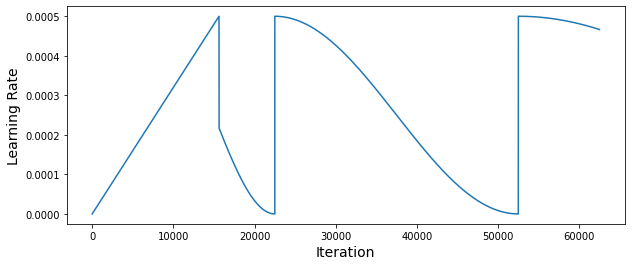

In [ ]:
learning_rate = WarmupLearningRateSchedule(
    params.scaled_lr,
    steps_per_epoch=params.train_step,
    decay_epochs=params.lr_decay_epoch,
    warmup_epochs=params.lr_warmup_epoch,
    decay_factor=params.lr_decay_factor,
    lr_decay_type=params.lr_sched,
    total_steps=params.total_steps,
    minimal_lr=params.scaled_lr_min,
)

rng = [i for i in range(params.total_steps)]
lr_y = [learning_rate(x) for x in rng]
plt.figure(figsize=(10, 4))
plt.plot(rng, lr_y)
plt.xlabel("Iteration", size=14)
plt.ylabel("Learning Rate", size=14)

In [ ]:
# training
if physical_devices:
    model = get_model(plot_summary=True, plot_graph=False)
    history = model.fit(
        train_ds,
        epochs=params.epochs,
        callbacks=[ckp, log],
        validation_data=val_ds,
        verbose=params.verbosity,
    ).history
    
    model.load_weights("/content/model/model.tf")
    display(pd.DataFrame(history).tail(5))
#else:
#    keras.mixed_precision.set_global_policy("float32")
#    model = get_model(plot_summary=True, plot_graph=False)
#    model(tf.ones((1, params.image_size, params.image_size, 3)))[0].shape

    # get trained weight and history file
#    weight = get_model_weight(model_id="/content/model/model.tf.data-00000-of-00001")
#    model.load_weights(weight)

#    history_csv = get_model_history(history_id="1J6QgHUqtYL0mIWC2h0K6HeIHcollfRUe")
#    history = pd.read_csv(history_csv)
#    display(history.tail())
#


Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 384, 384, 3  0           []                               
                                )]                                                                
                                                                                                  
 efficientnet (Functional)      [(None, 24, 24, 672  4049571     ['input_2[0][0]']                
                                ),                                                                
                                 (None, 12, 12, 128                                               
                                0)]                                                               
                                                                                            

None

Epoch 1/20

Epoch 1: val_accuracy improved from -inf to 0.54400, saving model to /content/model/model.tf
2500/2500 - 305s - loss: 0.9813 - accuracy: 0.4997 - val_loss: 0.6825 - val_accuracy: 0.5440 - 305s/epoch - 122ms/step
Epoch 2/20

Epoch 2: val_accuracy improved from 0.54400 to 0.74900, saving model to /content/model/model.tf
2500/2500 - 243s - loss: 0.8970 - accuracy: 0.5458 - val_loss: 0.5364 - val_accuracy: 0.7490 - 243s/epoch - 97ms/step
Epoch 3/20

Epoch 3: val_accuracy improved from 0.74900 to 0.83900, saving model to /content/model/model.tf
2500/2500 - 244s - loss: 0.6221 - accuracy: 0.7213 - val_loss: 0.4710 - val_accuracy: 0.8390 - 244s/epoch - 98ms/step
Epoch 4/20

Epoch 4: val_accuracy improved from 0.83900 to 0.95400, saving model to /content/model/model.tf
2500/2500 - 246s - loss: 0.4072 - accuracy: 0.8615 - val_loss: 0.2754 - val_accuracy: 0.9540 - 246s/epoch - 99ms/step
Epoch 5/20

Epoch 5: val_accuracy improved from 0.95400 to 0.97600, saving model to /content/model

,loss,accuracy,val_loss,val_accuracy
15,0.158671,0.98795,0.243705,0.995
16,0.152342,0.99100,0.285413,0.980
17,0.152969,0.99000,0.277784,0.989
18,0.148994,0.99085,0.261054,0.991
19,0.146280,0.99180,0.253017,0.990


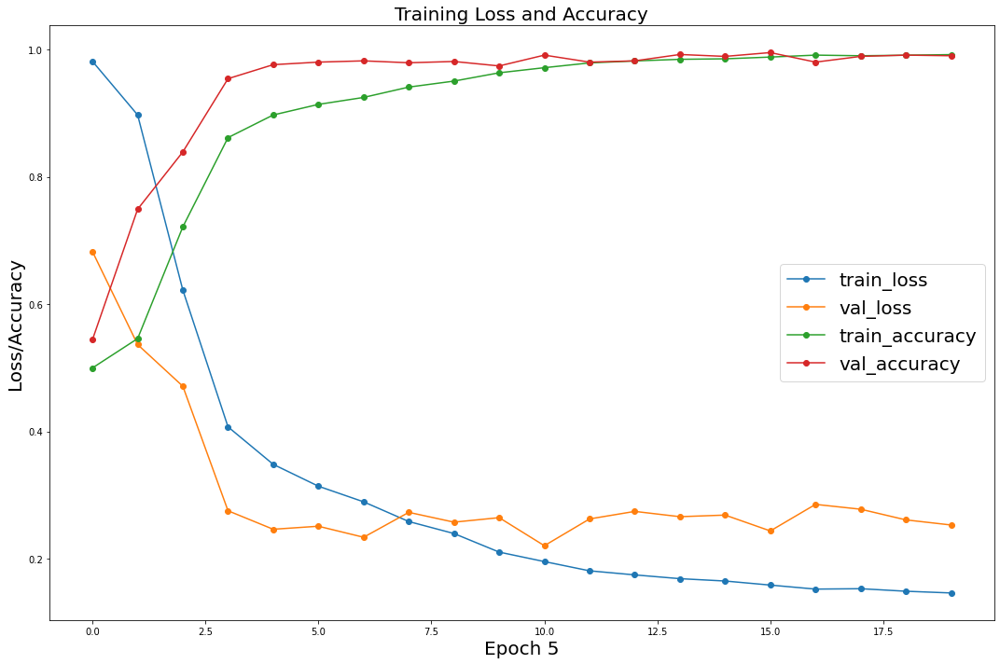

In [ ]:
# Plotting
plt.figure(figsize=(15, 10))
plt.plot(range(len(history["loss"])), history["loss"], "-o", label="train_loss")
plt.plot(range(len(history["loss"])), history["val_loss"], "-o", label="val_loss")
plt.plot(range(len(history["loss"])), history["accuracy"], "-o", label="train_accuracy")
plt.plot(
    range(len(history["loss"])), history["val_accuracy"], "-o", label="val_accuracy"
)
plt.title("Training Loss and Accuracy", fontdict={'fontsize':20})
plt.xlabel(f"Epoch {len(history) + 1}", fontsize=20)
plt.ylabel("Loss/Accuracy", fontsize=20)
plt.legend(loc="best", prop={"size": 20})
plt.tight_layout()
plt.show()

*Hybrid-EfficientNet-Swin-Transformer*

In [ ]:
def plot_stuff(inputs, features_a, features_b):
    plt.figure(figsize=(25, 25))
    
    plt.subplot(1, 3, 1)
    plt.axis('off')
    plt.imshow(tf.squeeze(inputs/255, axis=0))
    plt.title('Input')
    
    plt.subplot(1, 3, 2)
    plt.axis('off') 
    plt.imshow(features_a)
    #plt.matshow(features_a)
    plt.title('CNN')
    
    plt.subplot(1, 3, 3)
    plt.axis('off')  
    plt.imshow(features_b)
    plt.title('EfficientNet+Swin-Transformer')
    plt.show()

# ref: https://keras.io/examples/vision/grad_cam/
def get_img_array(img):
    #array = keras.utils.img_to_array(img)
    array = keras.preprocessing.image.img_to_array(img)
    array = np.expand_dims(array, axis=0)
    return array

# ref: https://keras.io/examples/vision/grad_cam/
def make_gradcam_heatmap(img_array, grad_model, pred_index=None):
    with tf.GradientTape(persistent=True) as tape:
        preds, base_top, swin_top = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(preds[0])
        class_channel = preds[:, pred_index]

    grads = tape.gradient(class_channel, base_top)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    base_top = base_top[0]
    heatmap_a = base_top @ pooled_grads[..., tf.newaxis]
    heatmap_a = tf.squeeze(heatmap_a)
    heatmap_a = tf.maximum(heatmap_a, 0) / tf.math.reduce_max(heatmap_a)
    heatmap_a = heatmap_a.numpy()

    grads = tape.gradient(class_channel, swin_top)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    swin_top = swin_top[0]
    heatmap_b = swin_top @ pooled_grads[..., tf.newaxis]
    heatmap_b = tf.squeeze(heatmap_b)
    heatmap_b = tf.maximum(heatmap_b, 0) / tf.math.reduce_max(heatmap_b)
    heatmap_b = heatmap_b.numpy()
    return heatmap_a, heatmap_b

In [ ]:
# Get val images
img_arrays = next(iter(val_ds))[0]
print(img_arrays.shape)

# plot utils
for img_array in img_arrays[:3]:
    # Generate class activation heatmap
    img_array = get_img_array(img_array)
    cnn_heatmap, swin_heatmap = make_gradcam_heatmap(img_array, model)
    print(cnn_heatmap.shape, cnn_heatmap.max(), cnn_heatmap.min())
    print(swin_heatmap.shape, swin_heatmap.max(), swin_heatmap.min())

    # Display heatmap
    #plot_stuff(img_array, cnn_heatmap, swin_heatmap)

(8, 384, 384, 3)
(12, 12) 1.0 0.0
(12, 12) 1.0 0.0427
(12, 12) 1.0 0.00626
(12, 12) 1.0 0.1183
(12, 12) 1.0 0.0
(12, 12) 1.0 0.179


In [ ]:
#ref: https://keras.io/examples/vision/grad_cam/
def save_and_display_gradcam(
    img,
    heatmap,
    target=None,
    pred=None,
    cam_path="cam.jpg",
    cmap="jet",  # inferno, viridis
    alpha=0.6,
    plot=None,
):
    # Rescale heatmap to a range 0-255
    heatmap = np.uint8(255 * heatmap)

    # Use jet colormap to colorize heatmap
    jet = cm.get_cmap(cmap)

    # Use RGB values of the colormap
    jet_colors = jet(np.arange(256))[:, :3]
    jet_heatmap = jet_colors[heatmap]

    # Create an image with RGB colorized heatmap
    jet_heatmap = keras.utils.array_to_img(jet_heatmap)
    jet_heatmap = jet_heatmap.resize((img.shape[0], img.shape[1]))
    jet_heatmap = keras.utils.img_to_array(jet_heatmap)

    # Superimpose the heatmap on original image
    superimposed_img = img + jet_heatmap * alpha
    superimposed_img = keras.utils.array_to_img(superimposed_img)
    return superimposed_img

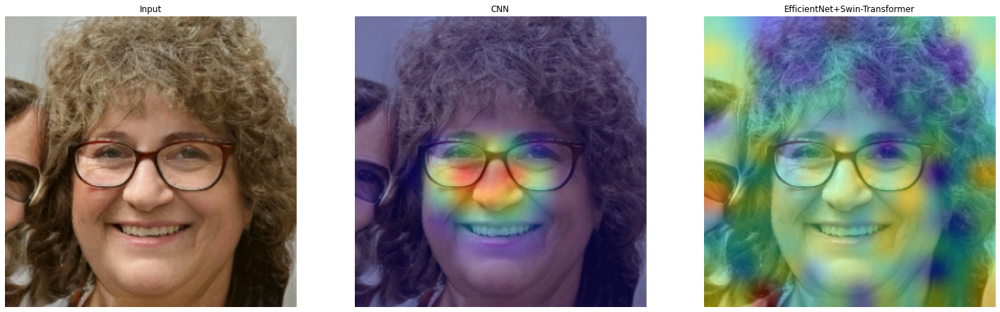

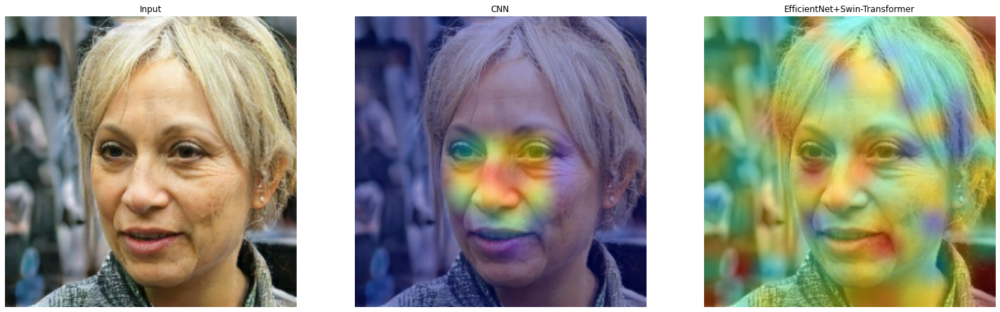

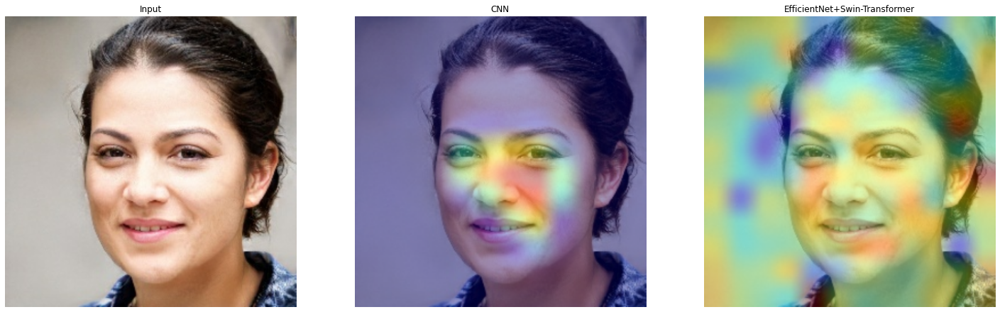

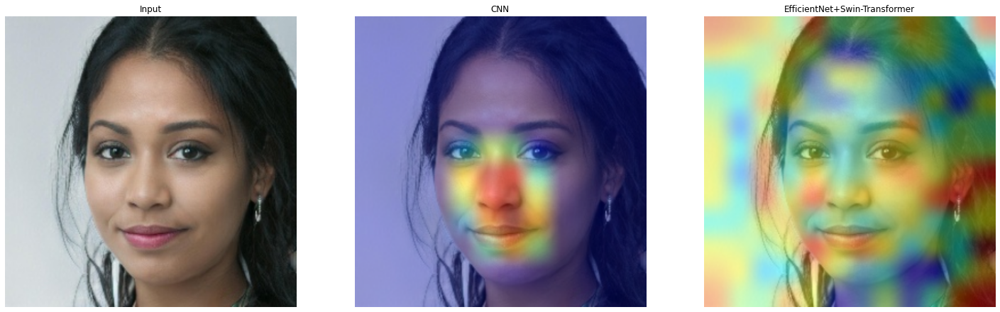

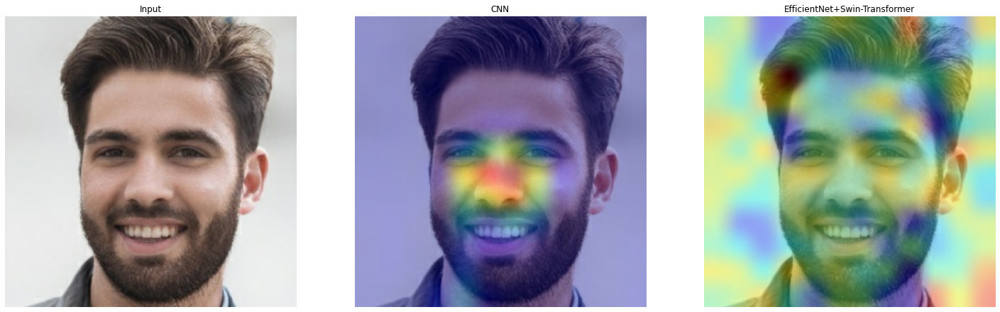

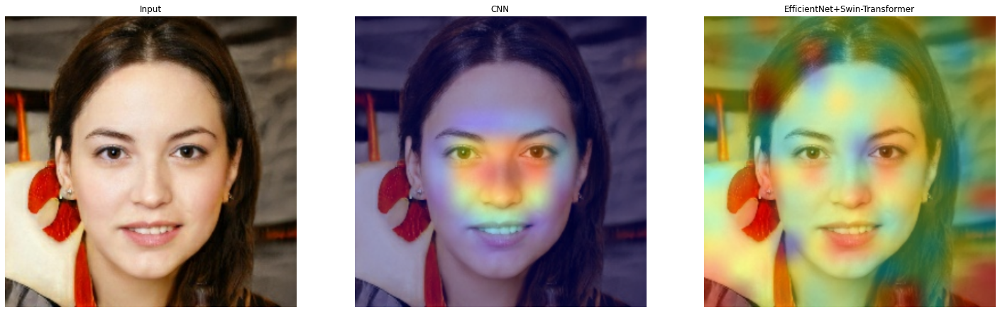

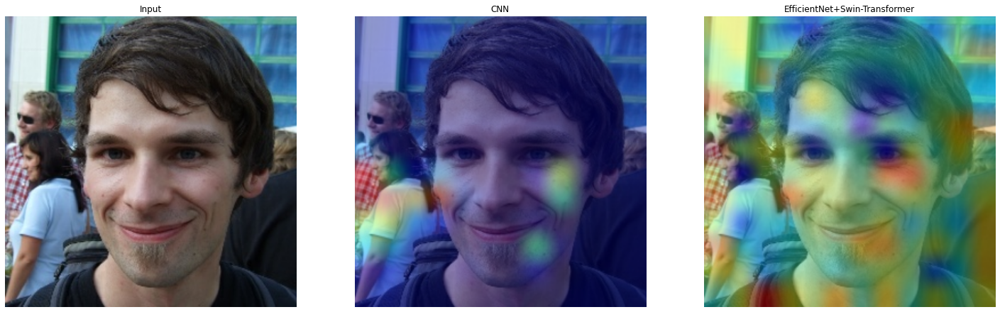

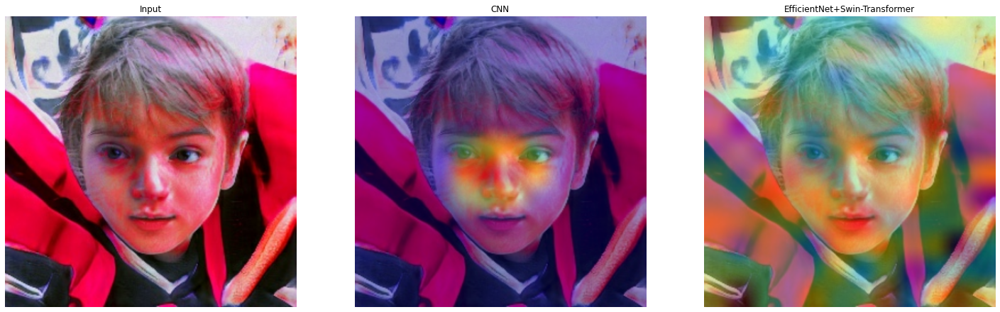

In [ ]:
samples, labels = next(iter(val_ds.shuffle(params.batch_size)))

for sample, label in zip(samples, labels):
    # preparing
    img_array = sample[tf.newaxis, ...]

    # get heatmaps
    heatmap_a, heatmap_b = make_gradcam_heatmap(img_array, model)

    # overaly heatmap and input sample
    overaly_a = save_and_display_gradcam(sample, heatmap_a)
    overlay_b = save_and_display_gradcam(sample, heatmap_b)

    # ploting stuff
    plot_stuff(img_array, overaly_a, overlay_b)

In [ ]:
# Calling `save('my_model')` creates a SavedModel folder `my_model`.
model.save("saved_model")


# It can be used to reconstruct the model identically.
reconstructed_model = keras.models.load_model(
    "saved_model",
    custom_objects={"WarmupLearningRateSchedule": WarmupLearningRateSchedule},
)

In [ ]:
from sklearn.metrics import classification_report, confusion_matrix
predictions = model.predict(test_ds)

y_pred = []
y_true = []

# iterate over the dataset
for image_batch, label_batch in test_ds:   # use dataset.unbatch() with repeat
   # append true labels
   y_true.append(label_batch)
   # compute predictions
   preds = model.predict(image_batch)
   # append predicted labels
   y_pred.append(np.argmax(preds[0], axis = - 1))

# convert the true and predicted labels into tensors
true_labels = tf.concat([item for item in y_true], axis = 0)
predicted_labels = tf.concat([item for item in y_pred], axis = 0)


#from sklearn.metrics import confusion_matrix

#cm = confusion_matrix(true_labels, predicted_labels)
#print(cm)

In [ ]:
from sklearn.metrics import confusion_matrix

cm = confusion_matrix(true_labels, predicted_labels)
print(cm)

[[2484   16]
 [  13 2487]]


In [ ]:
print(classification_report(true_labels, predicted_labels, target_names=test_ds.class_names))

              precision    recall  f1-score   support

        fake       0.99      0.99      0.99      2500
        real       0.99      0.99      0.99      2500

    accuracy                           0.99      5000
   macro avg       0.99      0.99      0.99      5000
weighted avg       0.99      0.99      0.99      5000



Area under the Receiver Operating Characteristic curve: 0.9942000000000001


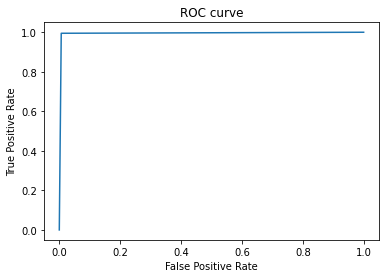

In [ ]:
from sklearn.metrics import roc_auc_score, roc_curve
fpr, tpr, thresholds = roc_curve(true_labels, predicted_labels)
plt.plot(fpr, tpr)
plt.title('ROC curve')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
print('Area under the Receiver Operating Characteristic curve:', 
      roc_auc_score(true_labels, predicted_labels))